# Road Crash Severity Prediction & Hotspot Detection in Nairobi

## Overview

Road traffic crashes represent a critical public health crisis in Kenya, with profound socioeconomic implications:

-Leading cause of death for young adults in Kenya.

-12th most common cause of death across all age groups

-Kenya's road traffic fatality rate of 28 deaths per 100,000 people mirrors the broader sub-Saharan African crisis (27 per 100,000).

-92% of crash fatalities occur in low- and middle-income countries like Kenya.

-Tragic incidents like the April 1, 2024 five-vehicle crash on Nairobi-Mombasa highway (11 deaths, 7 from one family) highlight the devastating human cost

Nairobi faces frequent road traffic accidents resulting in injuries, deaths, and economic losses. Current road safety measures are mostly reactive and lack predictive insights. This project uses machine learning and geospatial clustering to predict crash severity and detect accident hotspots, helping stakeholders like NTSA and urban planners take proactive, data-driven safety actions.

## Business Understanding 

## Problem Statement

There is no existing predictive system in Nairobi to determine the likelihood or severity of road crashes, making it hard for authorities to target interventions. 
The primary goal of the  project is to  address this gap by building a machine learning–powered web app that forecasts crash severity and visualizes high-risk zones based on historical crash data.
This will enable Kenyan authorities to:

-Forecast crash severity in different locations and conditions

-Visualize high-risk zones for targeted interventions

-Optimize resource allocation by focusing on the most dangerous road segments

-Enable proactive safety measures rather than reactive responses

##### Expected Impact:
-Reduce road traffic fatalities and injuries through data-driven interventions

-Maximize return on investment for road safety initiatives

-Support evidence-based policy making for transport authorities

-Contribute to achieving SDG target 3.6 (reducing road traffic deaths and injuries)

## Objectives 

The project aims to answer the following questions:
1. What  are the high-risk crash hotspots across the city, based on location and time patterns?
2. What is the crash severity based on day, hour, and other contextual features?
3. Build an interactive dashboard/ web app that allows users to input a date and time and
   receive high-risk location predictions and safety recommendations

In [3]:
#1. develop a model to predict crash severity using key road, time, and vehicle features,
#2. apply clustering to identify accident-prone areas,
#3. deploy a user-friendly web app for real-time predictions and hotspot mapping,
#4. generate actionable road safety insights for public agencies.

In [2]:
#1. Importing Libraries and Loading Data - Victoria
#2. Data Understanding - Victoria
#3. Exploratory Data Analysis - Victoria
#4. Modeling & Evaluation - Peter
#5. web app - Davies
#6. presentation slides (non-technical) - 
#7. readme - 
#8. Github - Davies
#9. Trello - Davies 
#10. Recommendations & Conclusions - 



## Data Understanding

The primary data source for this analysis is the popular Kenyan Twitter account @Ma3Route, which has over 1.4 million followers and serves as a crowdsourced platform where users actively share real-time information about transport and traffic conditions.
The dataset spans an 11-year period from August 2012 to July 2023 and includes over one million raw posts queried from the platform.

Through processing, 31,064 individual crash incidents were identified, with the majority of reports originating from Nairobi and its surrounding areas. To better analyze spatial patterns, crashes were grouped into 500-meter clusters using Ward’s hierarchical algorithm.

Crashes were geolocated using algorithmic extraction of road and landmark references, with 65% recall and 81% precision. The dataset highlights high-risk zones through spatial clustering, offering a valuable tool for targeted road safety interventions.

### 1. Importing Libraries and Loading Data

In [4]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import folium
from folium.plugins import HeatMap

C:\Users\user\anaconda3\envs\learn-env\lib\site-packages\requests\__init__.py:89: RequestsDependencyWarning: urllib3 (2.2.3) or chardet (3.0.4) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({}) doesn't match a supported "


In [2]:
# Load the dataset
df = pd.read_excel('nairobi-road-crashes-data_public-copy.xlsx', sheet_name='ma3route_crashes_algorithmcode')

In [3]:
# Display basic info
print(f"Dataset shape: {df.shape}")
print("\nFirst 5 rows:")
display(df.head())

Dataset shape: (31064, 10)

First 5 rows:


,crash_id,crash_datetime,crash_date,latitude,longitude,n_crash_reports,contains_fatality_words,contains_pedestrian_words,contains_matatu_words,contains_motorcycle_words
0,1,2018-06-06 20:39:54,2018-06-06,-1.263030,36.764374,1,0,0,0,0
1,2,2018-08-17 06:15:54,2018-08-17,-0.829710,37.037820,1,1,0,0,0
2,3,2018-05-25 17:51:54,2018-05-25,-1.125301,37.003297,1,0,0,0,0
3,4,2018-05-25 18:11:54,2018-05-25,-1.740958,37.129026,1,0,0,0,0
4,5,2018-05-25 21:59:54,2018-05-25,-1.259392,36.842321,1,1,0,0,0


In [43]:
print("\nData types and missing values:")
display(df.info())


Data types and missing values:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31064 entries, 0 to 31063
Data columns (total 10 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   crash_id                   31064 non-null  int64         
 1   crash_datetime             31064 non-null  datetime64[ns]
 2   crash_date                 31064 non-null  datetime64[ns]
 3   latitude                   31064 non-null  float64       
 4   longitude                  31064 non-null  float64       
 5   n_crash_reports            31064 non-null  int64         
 6   contains_fatality_words    31064 non-null  int64         
 7   contains_pedestrian_words  31064 non-null  int64         
 8   contains_matatu_words      31064 non-null  int64         
 9   contains_motorcycle_words  31064 non-null  int64         
dtypes: datetime64[ns](2), float64(2), int64(6)
memory usage: 2.4 MB


None

In [44]:
print("\nSummary statistics:")
display(df.describe())


Summary statistics:


,crash_id,crash_datetime,crash_date,latitude,longitude,n_crash_reports,contains_fatality_words,contains_pedestrian_words,contains_matatu_words,contains_motorcycle_words
count,31064.000000,31064,31064,31064.000000,31064.000000,31064.000000,31064.000000,31064.000000,31064.000000,31064.000000
mean,15532.500000,2017-07-01 01:41:02.041301760,2017-06-30 12:14:52.814833920,-1.272481,36.852499,1.400914,0.073526,0.030389,0.081799,0.036763
min,1.000000,2012-08-08 08:35:06,2012-08-08 00:00:00,-3.100000,36.283950,1.000000,0.000000,0.000000,0.000000,0.000000
25%,7766.750000,2015-05-04 14:55:03.249999872,2015-05-04 00:00:00,-1.316142,36.798093,1.000000,0.000000,0.000000,0.000000,0.000000
50%,15532.500000,2016-11-05 08:03:37,2016-11-05 00:00:00,-1.281033,36.840281,1.000000,0.000000,0.000000,0.000000,0.000000
75%,23298.250000,2019-06-28 08:24:29.500000,2019-06-28 00:00:00,-1.244783,36.891427,1.000000,0.000000,0.000000,0.000000,0.000000
max,31064.000000,2023-07-12 20:30:57,2023-07-12 00:00:00,-0.565402,37.879490,66.000000,1.000000,1.000000,1.000000,1.000000
std,8967.548717,NaN,NaN,0.118961,0.113650,1.486540,0.261002,0.171658,0.274062,0.188182


### 2. Data Cleaning and Preprocessing

Convert datetime columns

In [45]:
df['crash_datetime'] = pd.to_datetime(df['crash_datetime'])
df['crash_date'] = pd.to_datetime(df['crash_date']).dt.date

Extract time features

In [46]:
df['crash_hour'] = df['crash_datetime'].dt.hour
df['crash_dayofweek'] = df['crash_datetime'].dt.dayofweek  # Monday=0, Sunday=6
df['crash_month'] = df['crash_datetime'].dt.month

Check for duplicates

In [47]:
print(f"Number of duplicate rows: {df.duplicated().sum()}")

Number of duplicate rows: 0


Check for missing values

In [48]:
print("\nMissing values per column:")
display(df.isnull().sum())


Missing values per column:


crash_id                     0
crash_datetime               0
crash_date                   0
latitude                     0
longitude                    0
n_crash_reports              0
contains_fatality_words      0
contains_pedestrian_words    0
contains_matatu_words        0
contains_motorcycle_words    0
crash_hour                   0
crash_dayofweek              0
crash_month                  0
dtype: int64

 Verify coordinates are within reasonable Nairobi bounds

In [49]:
print("\nCoordinate ranges:")
print(f"Latitude: {df['latitude'].min()} to {df['latitude'].max()}")
print(f"Longitude: {df['longitude'].min()} to {df['longitude'].max()}")


Coordinate ranges:
Latitude: -3.10000000200807 to -0.565402313796744
Longitude: 36.2839500025994 to 37.8794900005407


## 3. Exploratory Data Analysis

### 3.1 Temporal Analysis

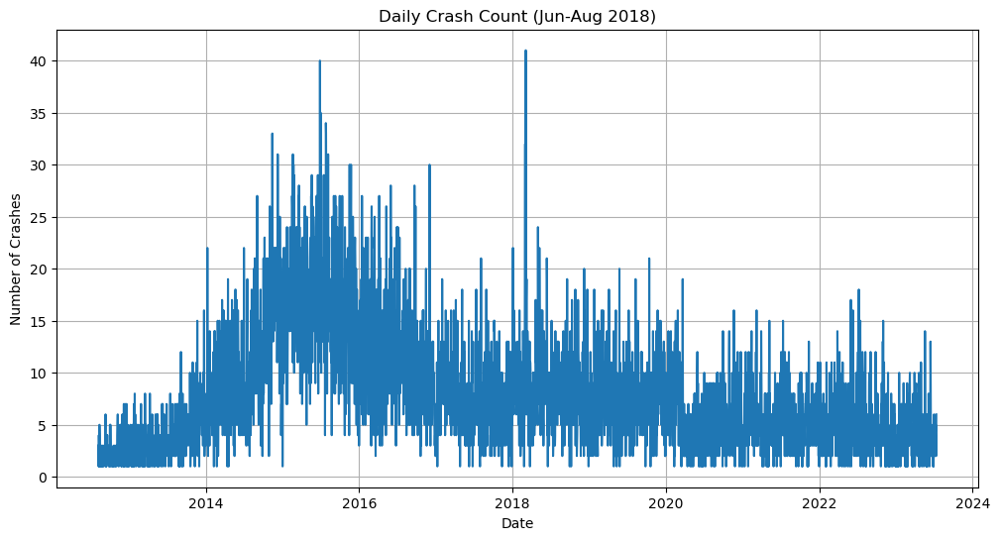

In [50]:
# Daily crash count
plt.figure(figsize=(12, 6))
df['crash_date'].value_counts().sort_index().plot()
plt.title('Daily Crash Count (Jun-Aug 2018)')
plt.xlabel('Date')
plt.ylabel('Number of Crashes')
plt.grid(True)
plt.show()

-The number of reported crashes increased steadily until mid-2015, after which they began to decline.

-This decrease in reports after 2015 may reflect reduced use of @Ma3Route rather than an actual drop in crash occurrences. Similarly, in March 2020, a sharp decline in reported crashes coincided with the introduction of social distancing measures and a curfew in response to COVID-19.

-While this reduction may indicate fewer crashes—an effect observed in other settings—it could also be attributed to fewer people on the roads to report incidents. 

#### Hourly distribution

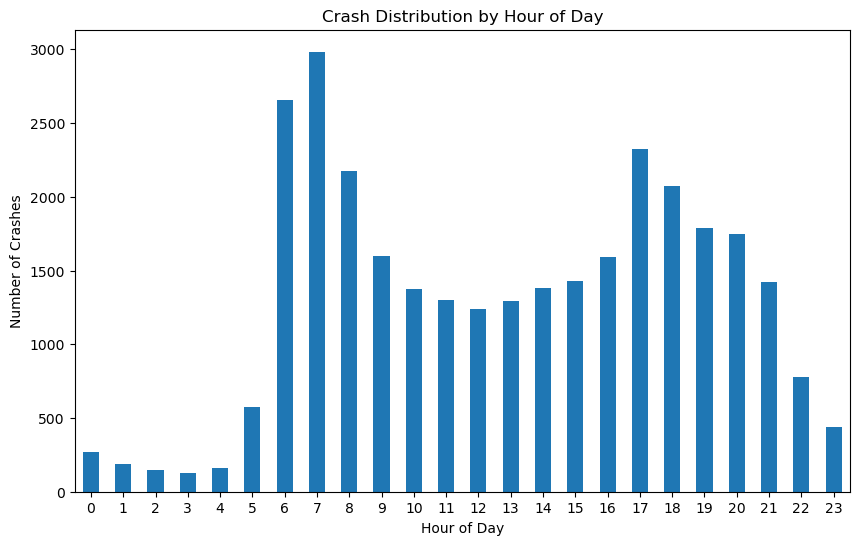

In [51]:
plt.figure(figsize=(10, 6))
df['crash_hour'].value_counts().sort_index().plot(kind='bar')
plt.title('Crash Distribution by Hour of Day')
plt.xlabel('Hour of Day')
plt.ylabel('Number of Crashes')
plt.xticks(rotation=0)
plt.show()

-The highest number of crashes  occurs during late afternoon/evening hours (e.g., 15:00–19:00 or 3 PM–7 PM), coinciding with rush-hour traffic, school pick-up times, or reduced visibility at dusk.

-A secondary peak may appear in the morning (e.g., 7:00–9:00 AM), also tied to rush hour.

-The fewest crashes occur during late-night/early-morning hours (e.g., 0:00–5:00 or midnight–5 AM), when traffic volume is minimal.

-There is a gradual increase from early mornings (6:00 AM) to afternoon and a sharp decline after the evening peak, reaching the lowest point overnight.

####  Day of week distribution

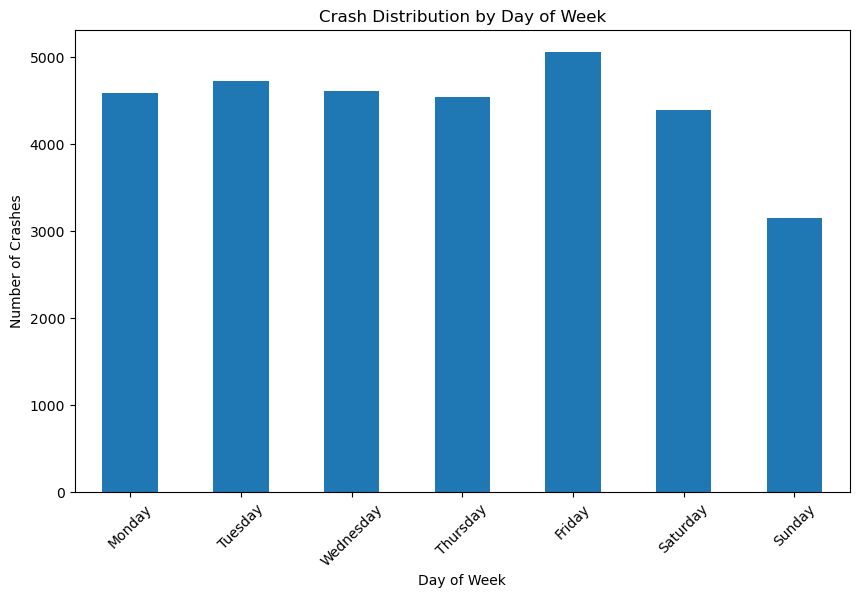

In [52]:
weekday_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
plt.figure(figsize=(10, 6))
df['crash_dayofweek'].value_counts().sort_index().plot(kind='bar')
plt.title('Crash Distribution by Day of Week')
plt.xlabel('Day of Week')
plt.ylabel('Number of Crashes')
plt.xticks(range(7), weekday_names, rotation=45)
plt.show()

Friday and Saturday are likely the days with the highest number of crashes, attributed to:

-Increased traffic volume (e.g., weekend travel, commuters leaving work early on Friday).

-Social activities (e.g., nightlife on Saturday leading to impaired driving).

-Sunday may also show elevated crashes due to return travel from weekend trips.

-Tuesday, Wednesday, and Thursday typically have fewer crashes, reflecting stable weekday routines with less recreational travel.

### 3.2 Crash Characteristics

 #### Co-occurrence of crash types

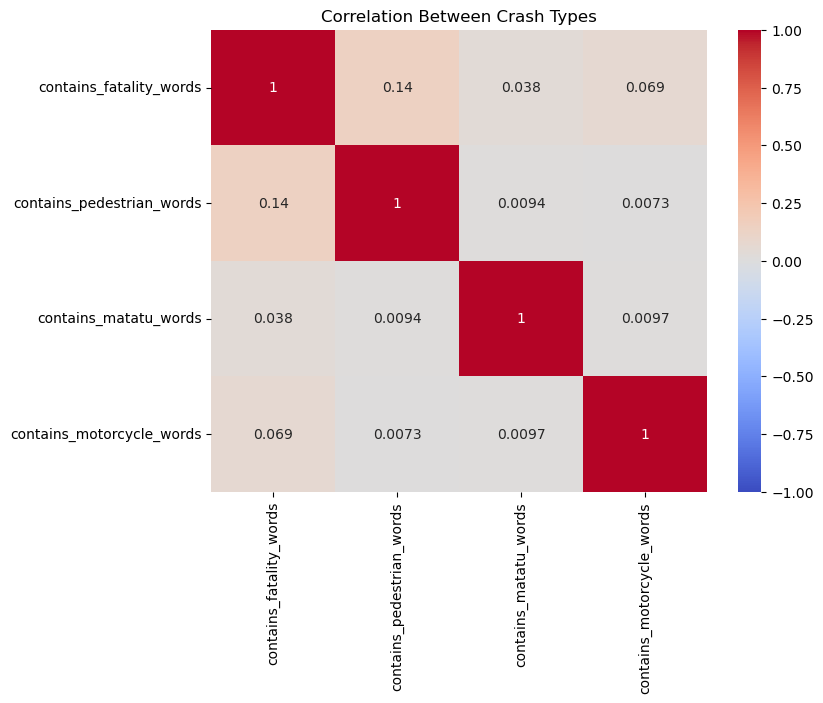

In [54]:
plt.figure(figsize=(8, 6))
sns.heatmap(df[crash_types].corr(), annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Between Crash Types')
plt.show()

-Fatality crashes (contains_fatality_words) have the strongest correlation with pedestrian crashes (0.14), but it's still quite weak.The slight positive correlation between fatality and pedestrian crashes (0.14) might suggest pedestrian accidents have a higher likelihood of involving fatalities.

-Pedestrian crashes show minimal overlap with matatu crashes (0.0094) and motorcycle crashes (0.0073).The transportation modes (matatu, motorcycle, pedestrian) operate relatively independently in terms of crash patterns

-Matatu and motorcycle crashes have almost no correlation (0.0097)

### 3.3 Geographic Analysis
####  Create base map centered on Nairobi

In [55]:
nairobi_coords = [-1.286389, 36.817222]  # Approximate center of Nairobi
m = folium.Map(location=nairobi_coords, zoom_start=12)

# Add heatmap
heat_data = [[row['latitude'], row['longitude']] for index, row in df.iterrows()]
HeatMap(heat_data, radius=15).add_to(m)

# Display the map
m.save('crash_heatmap.html')
display(m)

# Show clusters with most crashes
top_locations = df.groupby(['latitude', 'longitude']).size().sort_values(ascending=False).head(10)
print("Top 10 crash locations:")
display(top_locations)

Top 10 crash locations:


latitude   longitude
-1.267441  36.835518    201
-1.259367  36.843123    149
-1.331398  36.888555    136
-1.218637  36.891361    129
-1.203744  36.917527    122
-1.329937  36.871007    115
-1.259975  36.843418    113
-1.395628  36.941025    104
-1.274934  36.823417    102
-1.300013  36.787803     97
dtype: int64

Based on the cordinates, the areas are:
Around South B / Industrial Area

Close to Ngara / Parklands

Near Imara Daima / Mukuru area

Eastleigh / Mathare area

Muthaiga / Runda region

Around Pipeline / Mukuru kwa Njenga

Near Ngara again

Close to Ruiru bypass / Eastern outskirts

Westlands / Lavington area

Karen / Lang’ata region

-This represents the areas that are prone to road accidents in Nairobi.


4. Feature Engineering

In [56]:
# Create binary features for crash severity/types
df['fatal_crash'] = df['contains_fatality_words'].astype(int)
df['pedestrian_involved'] = df['contains_pedestrian_words'].astype(int)
df['matatu_involved'] = df['contains_matatu_words'].astype(int)
df['motorcycle_involved'] = df['contains_motorcycle_words'].astype(int)

In [57]:
# Create time-based features
df['rush_hour'] = df['crash_hour'].apply(lambda x: 1 if (7 <= x <= 9) or (16 <= x <= 19) else 0)
df['weekend'] = df['crash_dayofweek'].apply(lambda x: 1 if x >= 5 else 0)

In [58]:
# Create combined crash type feature
df['crash_type'] = 'other'
df.loc[df['fatal_crash'] == 1, 'crash_type'] = 'fatal'
df.loc[df['pedestrian_involved'] == 1, 'crash_type'] = 'pedestrian'
df.loc[df['matatu_involved'] == 1, 'crash_type'] = 'matatu'
df.loc[df['motorcycle_involved'] == 1, 'crash_type'] = 'motorcycle'

In [59]:
# For locations with multiple types, prioritize fatal crashes
df.loc[(df['fatal_crash'] == 1) & (df['pedestrian_involved'] == 1), 'crash_type'] = 'fatal_pedestrian'

5. Advanced Analysis

5.1 Spatial-Temporal Patterns

C:\Users\davie\AppData\Local\Temp\ipykernel_15684\1170063289.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset['crash_hour'], label=crash_type, shade=True)
C:\Users\davie\AppData\Local\Temp\ipykernel_15684\1170063289.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset['crash_hour'], label=crash_type, shade=True)
C:\Users\davie\AppData\Local\Temp\ipykernel_15684\1170063289.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(subset['crash_hour'], label=crash_type, shade=True)
C:\Users\davie\AppData\Local\Temp\ipykernel_15684\1170063289.py:6: FutureWarning: 

`shade` is now deprecated in favor of `fill`; set

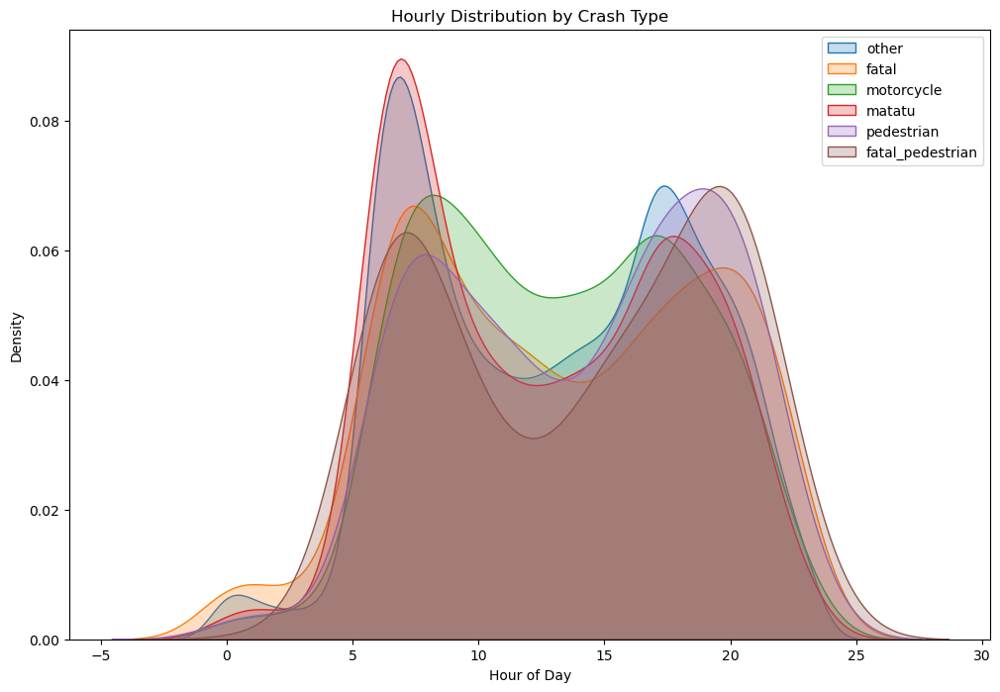

In [60]:
# Hourly patterns by crash type
plt.figure(figsize=(12, 8))
for crash_type in df['crash_type'].unique():
    subset = df[df['crash_type'] == crash_type]
    if len(subset) > 10:  # Only plot types with sufficient data
        sns.kdeplot(subset['crash_hour'], label=crash_type, shade=True)
plt.title('Hourly Distribution by Crash Type')
plt.xlabel('Hour of Day')
plt.legend()
plt.show()

<Figure size 1200x600 with 0 Axes>

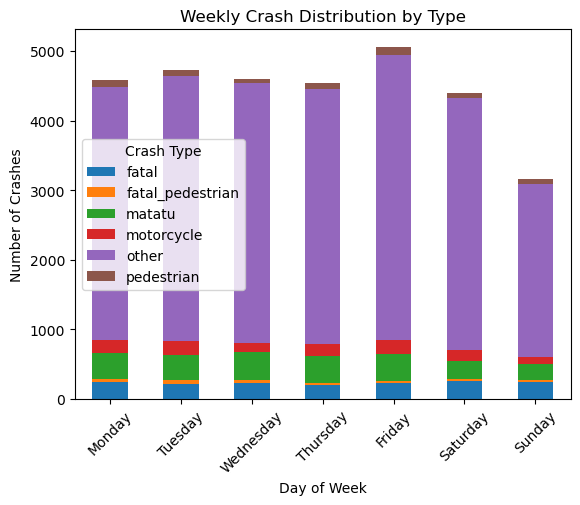

In [61]:
# Weekly patterns
plt.figure(figsize=(12, 6))
df.groupby(['crash_dayofweek', 'crash_type']).size().unstack().plot(kind='bar', stacked=True)
plt.title('Weekly Crash Distribution by Type')
plt.xlabel('Day of Week')
plt.ylabel('Number of Crashes')
plt.xticks(range(7), weekday_names, rotation=45)
plt.legend(title='Crash Type')
plt.show()

5.2 Hotspot Analysis

In [62]:
pip install geopy

Note: you may need to restart the kernel to use updated packages.


In [63]:
from sklearn.cluster import DBSCAN
from geopy.distance import great_circle

# Convert coordinates to radians for DBSCAN
coords = df[['latitude', 'longitude']].values
kms_per_radian = 6371.0088
epsilon = 0.5 / kms_per_radian  # 0.5 km cluster radius

# Perform DBSCAN clustering
db = DBSCAN(eps=epsilon, min_samples=5, algorithm='ball_tree', metric='haversine').fit(np.radians(coords))
df['cluster'] = db.labels_

# Number of clusters
n_clusters = len(set(db.labels_)) - (1 if -1 in db.labels_ else 0)
print(f"Number of crash hotspots identified: {n_clusters}")

# Plot clusters on map
m = folium.Map(location=nairobi_coords, zoom_start=12)
colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred']

for idx, row in df.iterrows():
    if row['cluster'] != -1:  # Only plot clustered points
        folium.CircleMarker(
            location=[row['latitude'], row['longitude']],
            radius=5,
            color=colors[row['cluster'] % len(colors)],
            fill=True,
            fill_color=colors[row['cluster'] % len(colors)]
        ).add_to(m)

# Add cluster centers
cluster_centers = []
for cluster_id in range(n_clusters):
    cluster_points = df[df['cluster'] == cluster_id][['latitude', 'longitude']]
    center = cluster_points.mean().values
    cluster_centers.append(center)
    folium.Marker(
        location=center,
        icon=folium.Icon(color=colors[cluster_id % len(colors)], 
        popup=f"Hotspot {cluster_id+1}\n{len(cluster_points)} crashes"
    )).add_to(m)

m.save('crash_hotspots.html')
display(m)

Number of crash hotspots identified: 195


5.3 Crash Type Prediction

In [64]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix

# Prepare data for modeling
X = df[['crash_hour', 'crash_dayofweek', 'latitude', 'longitude', 'rush_hour', 'weekend']]
y = df['crash_type']  # or use 'fatal_crash' for binary classification

In [65]:
# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [66]:
# Train model
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [67]:
# Evaluate
y_pred = model.predict(X_test)
print(classification_report(y_test, y_pred))

                  precision    recall  f1-score   support

           fatal       0.05      0.01      0.02       316
fatal_pedestrian       0.00      0.00      0.00        50
          matatu       0.12      0.04      0.06       490
      motorcycle       0.09      0.02      0.03       247
           other       0.80      0.95      0.87      4984
      pedestrian       0.10      0.02      0.04       126

        accuracy                           0.77      6213
       macro avg       0.19      0.17      0.17      6213
    weighted avg       0.66      0.77      0.71      6213



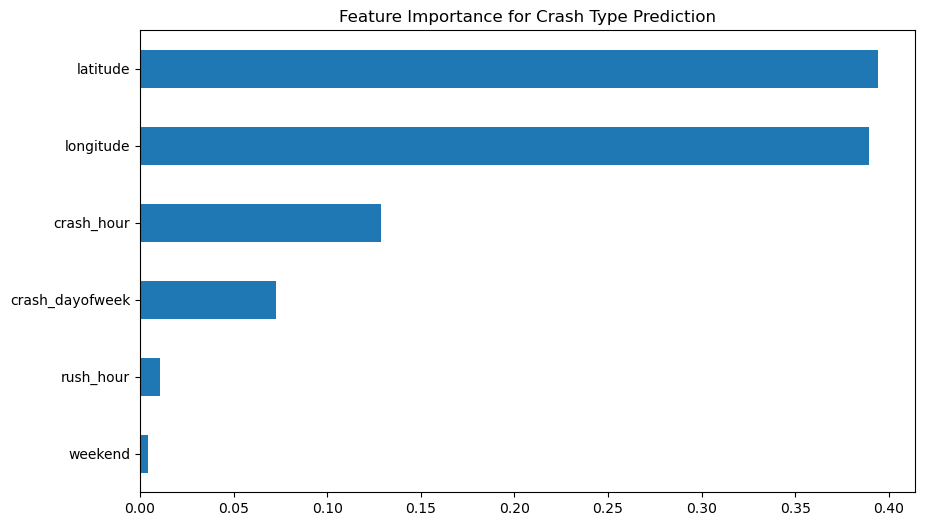

In [68]:
# Feature importance
plt.figure(figsize=(10, 6))
pd.Series(model.feature_importances_, index=X.columns).sort_values().plot(kind='barh')
plt.title('Feature Importance for Crash Type Prediction')
plt.show()